**Kaggle Dataset**: https://www.kaggle.com/datasets/uciml/breast-cancer-wisconsin-data?resource=download

**Kaggle Dataset Title**: *Breast Cancer Wisconsin (Diagnostic) Data Set*

Wolberg, W., Mangasarian, O., Street, N., & Street, W. (1993). Breast Cancer Wisconsin (Diagnostic) [Dataset]. UCI Machine Learning Repository. https://doi.org/10.24432/C5DW2B.

## Machine Learning 1: Supervised Learning Final Project - Breast Cancer Classification

### Project Topic

In women, breast cancer is the second leading cause of cancer death. Breast cancer accounts for about 1 in 3 new female diagnosis annually. Research shows it primarily impacts middle-aged and older females; however, cancer does not age discriminate. Women have about a 1 in 8 chance to develop breast cancer. As such, early detection is extremely important for good prognosis. In this project, I will be utilizing a dataset obtained from Kaggle titled *Breast Cancer Wisconsin (Diagnostic) Data Set*. The **type of learning/algorithms** I will be using are supervised learning methods including Logistic Regression, Decision Trees, and Support Vector Machines. The **type of task** is to produce an accurate and efficient model that would help diagnose (predict) whether someone has a malignent or benign tumor based on specific tumor features. The **motivation** behind this endeavor is to find ways to accurately provide early diagnosis to patients with breast cancer to increase the liklihood of remission through timely treatments.

Source: https://www.cancer.org/cancer/types/breast-cancer/about/how-common-is-breast-cancer.html

### Data

**Reference**<br>
As noted earlier, the dataset was obtained from Kaggle. However, the original source of the data is from the UCI Machine Learning Repository. The dataset was gathered from digitized images of fine needle aspirate (FNA) of breast tumors. The features provide details of the cell nuclei present in the image.

APA Citation:
<br>
Wolberg, W., Mangasarian, O., Street, N., & Street, W. (1993). Breast Cancer Wisconsin (Diagnostic) [Dataset]. UCI Machine Learning Repository. https://doi.org/10.24432/C5DW2B.

**Data Description**<br>
- Format: **tabulated data**<br>
- Data size: **569 samples**<br>
- Feature size: 30 features, 1 target variable (diagnosis), 1 ID column, and 1 column "Unamed: 32" that needs to be removed<br>
- Features: features 1 and 32 will be dropped as neither is related to determining whether someone has breast cancer. What we will be left with after data cleaning (explained below) is 1 target **binary (categorical)** variable and 30 **numeric features**.

**Description of Features**

Outlined below is the list of variables included in the raw data. 10 types of data points across three measurements were computed for each cell nucleus. For example, features 2 through 11, inclusive, represent the mean of each data type. Features 12 through 21, inclusive, represent the same data types but their standard deviation. Similarily, features 22 through 31, inclusive, represent the mean of the three largest values, labeled 'worst' for hte same set of data types. This data was obtained in a .csv file and no information is available as to whether the data was gathered in multi-table form or gathered from multiple sources.

- 0   id       
- 1   diagnosis       
- 2   radius_mean           
- 3   texture_mean          
- 4   perimeter_mean      
- 5   area_mean             
- 6   smoothness_mean     
- 7   compactness_mean       <br> 
- 8   concavity_mean           <br> 
- 9   concave points_mean     <br> 
- 10  symmetry_mean          <br> 
- 11  fractal_dimension_mean   <br> 
- 12  radius_se               <br> 
- 13  texture_se              <br> 
- 14  perimeter_se            <br> 
- 15  area_se                  <br> 
- 16  smoothness_se            <br>
- 17  compactness_se           <br> 
- 18  concavity_se             <br> 
- 19  concave points_se     <br> 
- 20  symmetry_se             <br> 
- 21  fractal_dimension_se     <br> 
- 22  radius_worst           <br> 
- 23  texture_worst         <br> 
- 24  perimeter_worst         <br> 
- 25  area_worst             <br> 
- 26  smoothness_worst         <br> 
- 27  compactness_worst        <br> 
- 28  concavity_worst         <br> 
- 29  concave points_worst     <br> 
- 30  symmetry_worst         <br> 
- 31  fractal_dimension_worst  <br> 
- 32  Unnamed: 32 

In [5]:
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import HistGradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.base import clone 
from sklearn import tree
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report
from sklearn.feature_selection import RFE
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.metrics import confusion_matrix
import matplotlib.pylab as plt 
%matplotlib inline 

In [145]:
# load data
df=pd.read_csv("data.csv")
# print first 5 rows to get a sense of the data structure
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [146]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

### Data Cleaning

**How and why I cleaned the data**: <br>
Before we can do exploratory data analysis (EDA), we must first ensure our data is clean and ready to be analyzed. As a first step, I explored whether there are any values that contian **blanks or null values**. It turns out there is a column that contains many NaN values named "Unnamed: 32". This column will create noise in our EDA step and issues when we get to creating our models. Therefore, we will **drop this column** completely. Moreover, as seen in the data section, we noticed the ID column is simply used to identify each person. For our purposes, it does not add value in terms of predicting whether someones tumor is malignant. We will also **drop this feature**.
<br><br>
Additionally, I noticed that the target variable 'diagnosis' is an object type. This will be problematic for our EDA and model step. To properly conduct EDA and produce models we need to exercise **data type munging** on the target variable and transform it to a binary form. 
<br><br>
Finally, I checked for **imbalances** and **outliers** in the dataset to better understand whether we need to be concerned about implementing techniques that are specific for imbalanced data.
<br><br>
**Conclusions / discussions**: <br>
In summary, I removed the id column as it does not add value to predicting whether someone has breast cancer. I have also removed the column titled "Unnamed: 32" as it contained NaN values. Such column would cause issues during both the EDA and model steps. Additionally, I have actioned data type munging on the target variable (e.g., "diagnosis") to ensure it is in binary form. Previously, the data type was object for this variable.
<br><br>
Moreover, I have checked for both imbalances and outliers to get a sense of the type of data to prepare for any **foreseen difficulties and/or analysis** that should be considered in the model step. For example, as **visualized** below, the data is moderately unbalanced. We would need to consider this as the models are produced. We also note, there is some degree of outliers. However, we will keep these in as they could contain important information to help us distinguish between someone who has breast cancer. The **strategy** will be to account for imbalances and outliers within the model step and not the data cleaning step.
<br><br>
**Visualizations**: <br>
What follows is visualizations of the data followed by the specific cleaning steps exercised as discussed in the aforementioned sections. I visualized the data to check for null values before removing them. Once removed, I checked to ensure it was properly completed. Further, I checked the data types and ensured the object target variable was appropriately converted to binary form. Additionally, I visualized the data for imbalances by creating a countplot via seaborn library to illustrate the imbalance visually and also included the counts above the chart. The outliers were visually reviewed via a pairplot through the seaborn library. Lastly, I noticed in the data step, when we printed the head of the data the features were not normalized amongst each other. This provides insight that I would need to leverage a technique to scale the data before the model step.

#### Drop NA and non-value added columns (e.g., "id")

In [147]:
# check for any null values
df.isnull().any()

id                         False
diagnosis                  False
radius_mean                False
texture_mean               False
perimeter_mean             False
area_mean                  False
smoothness_mean            False
compactness_mean           False
concavity_mean             False
concave points_mean        False
symmetry_mean              False
fractal_dimension_mean     False
radius_se                  False
texture_se                 False
perimeter_se               False
area_se                    False
smoothness_se              False
compactness_se             False
concavity_se               False
concave points_se          False
symmetry_se                False
fractal_dimension_se       False
radius_worst               False
texture_worst              False
perimeter_worst            False
area_worst                 False
smoothness_worst           False
compactness_worst          False
concavity_worst            False
concave points_worst       False
symmetry_w

In [148]:
df = df.drop(columns=["Unnamed: 32","id"])

#### Convert target variable ("diagnosis") into binary form - 1 = M and 0 = B

In [149]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

In [178]:
# make a copy of the df in case we need to revert back
df_clean = df.copy()
# check for unique values to ensure only 2 variables within column
print(f"Unique values for diagnosis column: {df_clean['diagnosis'].unique()}\n")
# re-map each variable to 1 - malignent and 0 - benign
df_clean['diagnosis'] = df_clean['diagnosis'].map({'M': 1, 'B': 0})
print(f"First 5 columns: {df_clean['diagnosis'].head(5)}\n")
print(f"Last 5 columns: {df_clean['diagnosis'].tail(5)}")

Unique values for diagnosis column: ['M' 'B']

First 5 columns: 0    1
1    1
2    1
3    1
4    1
Name: diagnosis, dtype: int64

Last 5 columns: 564    1
565    1
566    1
567    1
568    0
Name: diagnosis, dtype: int64


#### Data imbalance and outlier check

Counts: diagnosis
0    357
1    212
Name: count, dtype: int64


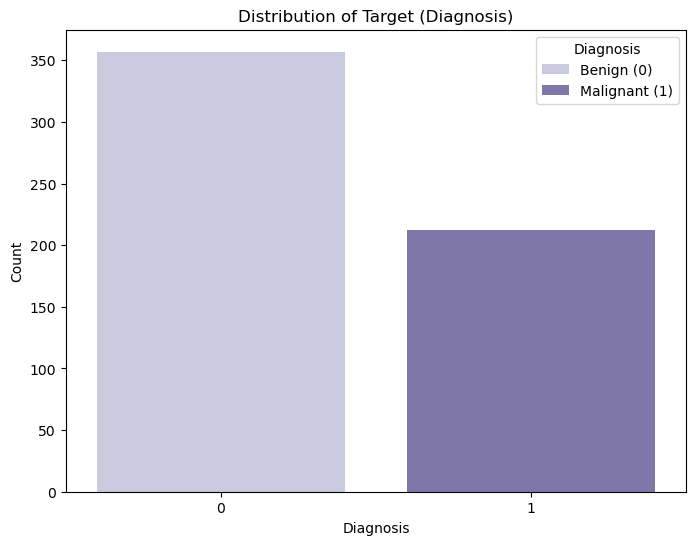

In [214]:
# check for data imbalance by counting how many 1s and 0s we have in the target variable
print(f"Counts: {df_clean['diagnosis'].value_counts()}")


# count plot
plt.figure(figsize=(8, 6))
sns.countplot(x='diagnosis', data=df_clean, hue='diagnosis', palette='Purples')
plt.title('Distribution of Target (Diagnosis)')
plt.xlabel('Diagnosis')
plt.ylabel('Count')
plt.legend(title='Diagnosis', labels=['Benign (0)', 'Malignant (1)'])
plt.xticks(rotation=0)
plt.show()

In [215]:
# check for data imbalance by counting how many 1s and 0s we have in the target variable

# pair plot
plt.figure(figsize=(8, 6))
sns.pairplot(data=df_clean, hue='diagnosis', palette='Purples')

<Figure size 800x600 with 0 Axes>

### Exploratory Data Analysis

**How and why Exploratory Data Analysis (EDA) is performed**: <br>
There are a number of reasons why EDA step is important before pivoting to the model step. First, we must understand the data to gain insights into its structure, potential trends, and check for imbalances as we have touched on in the data cleaning step. We can better understand the data by creating visualizations such as histograms to understand its frequency distribution across features (i.e., bell-shaped). This understanding may help inform our strategy in how we approach model selection. For example, do we take the approach of starting with a linear regression model? Or, do we take the approach of unsupervised learning methods such as classification techniques utilizing unlabeled data? It will also help shed light on whether there are any data quality issues, perhaps, missing values or a large volume of outliers that may impact our predictive capabilities. It also may help simplify the data by visualizing it so that it can be explained to senior stakeholders. In some cases, visualizing data in different ways such as correlation analysis via correlation matrix and seaborn's heatmap may help us better understand collinearity amongst variables. In other cases it can help inform feature engineering techniques.
<br><br>
**Analysis**: <br>
My approach with EDA was to create 3 sets of pairplots leveraging the seaborn library. This is because we have 30 features broken down into 3 neatly grouped sets - mean, standard deviation, and worst. I have taken the set of 10 features for mean and produced a pairplot, similarly, I have done the same for the latter two sets of 10 features to produce standard deviation and worst pairplots. In addition, for each pairplot I have decided to produce a histogram along the diagnol opposed to the KDE which was already produced across the entire dataset in the data cleaning section.
<br><br>
Reviewing the pairplots we can immediately notice there are definately outliers that are present throughout the data. However, the decision was made to keep such outliers as they could help inform the prediction model. Our sample set is relatively small, under 600 samples. Therefore, I will keep the outliers intact. Additionally, we saw from the previous section that the data is moderately unbalanced via the visualization we produced in the data cleaning section.
<br><br>
Further, I produced a correlation matrix and heatmap, leveraging the seaborn library. I masked out the duplicates from the heatmap for ease of analysis. We see that there are definately several variables that are strongly correlated with the target variable, diagnosis. Specifically, concave points_mean, radius_worst, perimeter_worst and concave points worst have a strong positive correlation with diagnosis. We should be aware of this and look into **feature importance** within our model step to ensure we avoid issues with including variables that may not add value to the models performance. I will consider backword feature elimination and take note which ones are removed.
<br><br>
Lastly, I produced statistical tests to get a sense of the type of data we have across all the features. We can definately see that the data may require scaling. Some of the data has small values such as 'symmetry', while others have large values such as 'area'. It will be important to ensure we use a normalization technique to scale our data such as StandardScaler from sklearn library before the model step.
<br><br>
**Conclusions / discussions**: <br>
In summary, while analyzing pairplots, correlation matrix, and statistics across the cleaned data we found several helpful tidbits that help inform how we should proceed next. Specifically, we will acknowledge that there are outliers in the data and leave them in as they may help inform whether someone has breast cancer. We will ensure we leverage a backword feature elimination technique to avoid adding unnecessary features to the model that don't help its accuracy and treat multi-collinearity issue that is evident from multiple features correlated with one another discovered from the heatmap. Lastly, we will ensure to scale our data informed by the **statistical** analysis to help improve the model performance.
<br><br>
**Visualizations**: <br>
What follows is the actual visualizations the aforementioned sections were based on. There are three sets of **pairplots** with a diagonal **histogram**, **correlation matrix**, **heatmap**, and **statistical analysis**.

<Figure size 800x600 with 0 Axes>

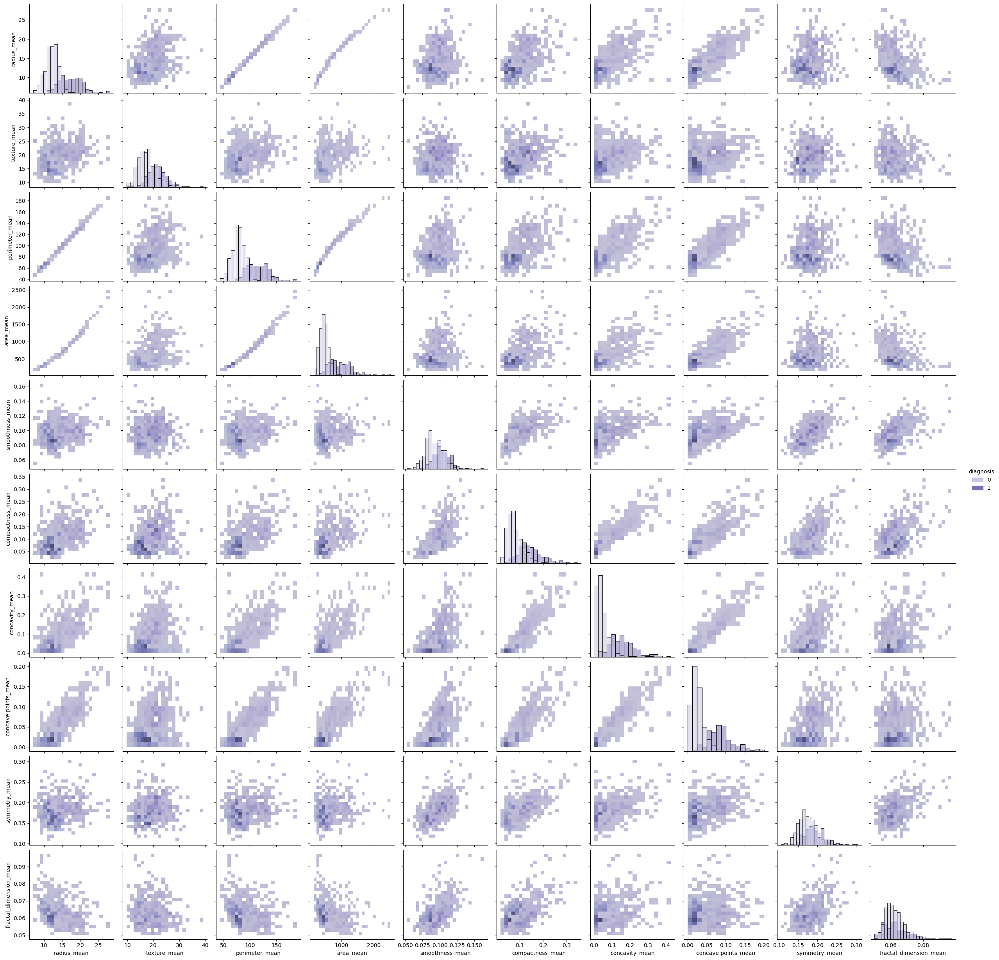

In [259]:
plt.figure(figsize=(8, 6))
sns.pairplot(data=df_clean,vars=['radius_mean',
                            'texture_mean',
                            'perimeter_mean',
                            'area_mean',
                            'smoothness_mean',
                            'compactness_mean',
                            'concavity_mean',
                            'concave points_mean',
                            'symmetry_mean',
                            'fractal_dimension_mean'], 
                             hue='diagnosis',palette='Purples',kind='hist')

<Figure size 800x600 with 0 Axes>

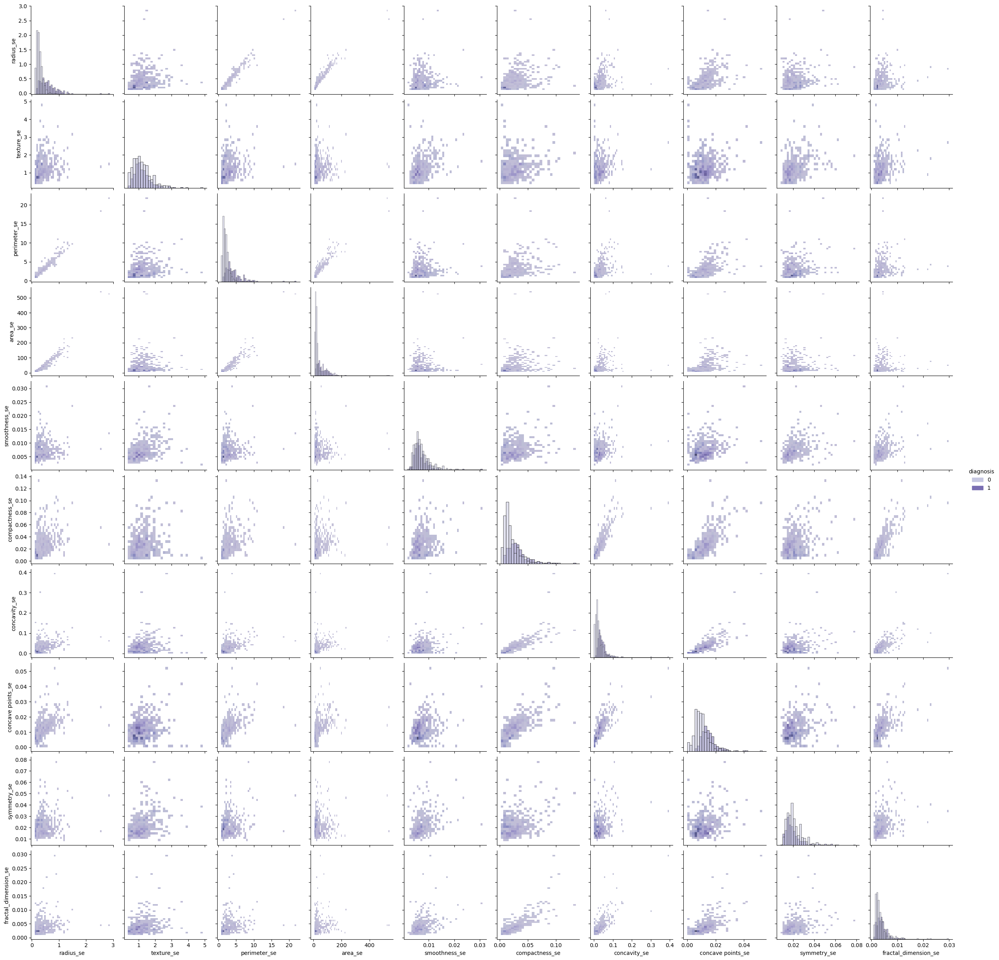

In [260]:
plt.figure(figsize=(8, 6))
sns.pairplot(data=df_clean,vars=['radius_se',
                            'texture_se',
                            'perimeter_se',
                            'area_se',
                            'smoothness_se',
                            'compactness_se',
                            'concavity_se',
                            'concave points_se',
                            'symmetry_se',
                            'fractal_dimension_se'], 
                             hue='diagnosis',palette='Purples',kind='hist')

<Figure size 800x600 with 0 Axes>

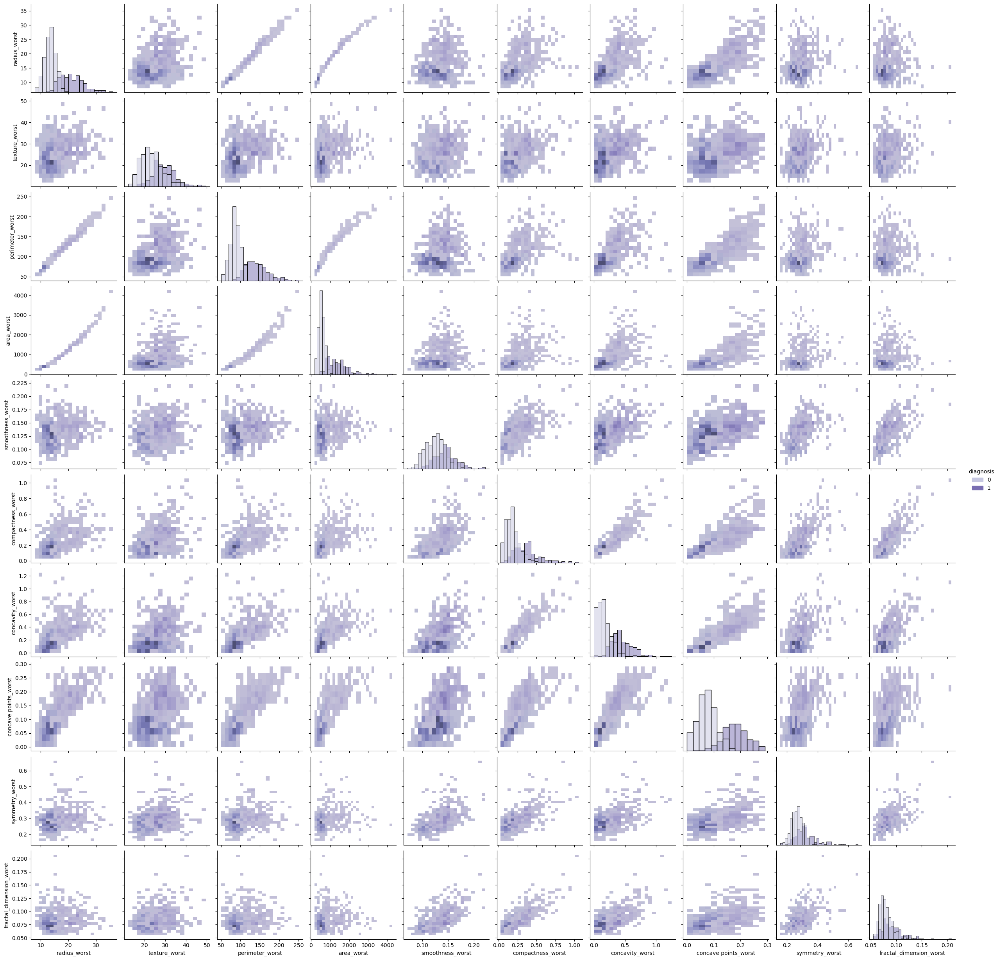

In [261]:
plt.figure(figsize=(8, 6))
sns.pairplot(data=df_clean,vars=['radius_worst',
                            'texture_worst',
                            'perimeter_worst',
                            'area_worst',
                            'smoothness_worst',
                            'compactness_worst',
                            'concavity_worst',
                            'concave points_worst',
                            'symmetry_worst',
                            'fractal_dimension_worst'], 
                             hue='diagnosis',palette='Purples',kind='hist')

In [220]:
# correlation matrix
correlation = df_clean.corr()
correlation

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,1.000000,0.730029,0.415185,0.742636,0.708984,0.358560,0.596534,0.696360,0.776614,0.330499,...,0.776454,0.456903,0.782914,0.733825,0.421465,0.590998,0.659610,0.793566,0.416294,0.323872
radius_mean,0.730029,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,...,0.969539,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066
texture_mean,0.415185,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,...,0.352573,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205
perimeter_mean,0.742636,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,...,0.969476,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019
area_mean,0.708984,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,...,0.962746,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738
smoothness_mean,0.358560,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,...,0.213120,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316
compactness_mean,0.596534,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,...,0.535315,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382
concavity_mean,0.696360,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,...,0.688236,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930
concave points_mean,0.776614,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,...,0.830318,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661
symmetry_mean,0.330499,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,...,0.185728,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413


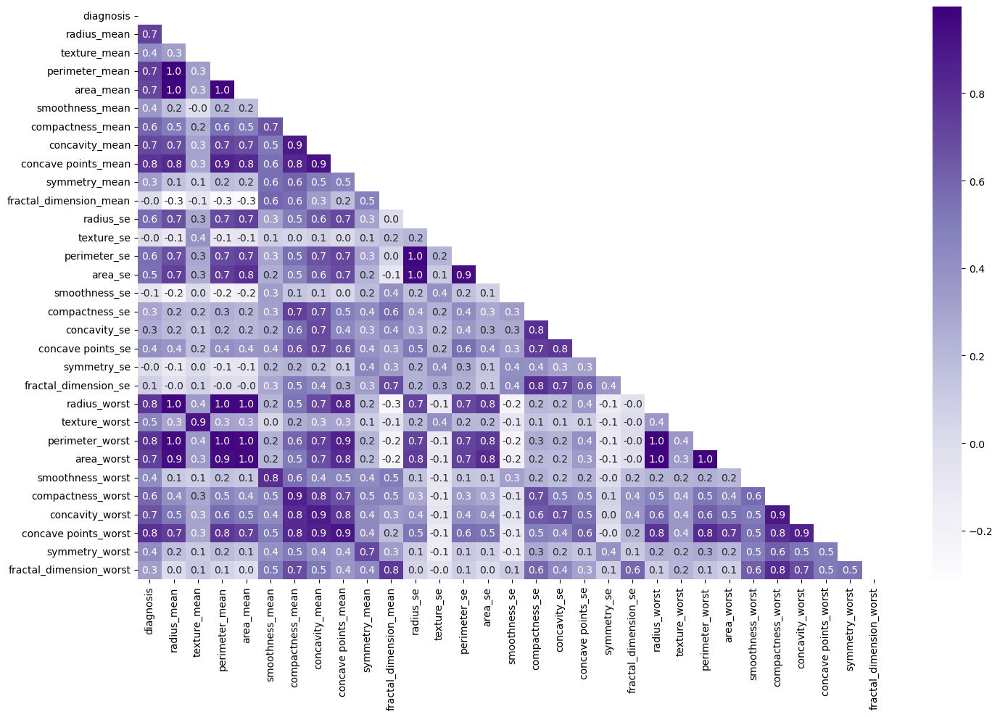

In [234]:
plt.figure(figsize=(15,10))
sns.heatmap(correlation, annot=True, fmt = ".1f", cmap = "Purples", mask =np.triu(np.ones_like(correlation, dtype=bool)))
plt.tight_layout()
plt.show()

In [249]:
# display statistics for each column
df_clean.describe().T

,count,mean,std,min,25%,50%,75%,max
diagnosis,569.0,0.372583,0.483918,0.000000,0.000000,0.000000,1.000000,1.00000
radius_mean,569.0,14.127292,3.524049,6.981000,11.700000,13.370000,15.780000,28.11000
texture_mean,569.0,19.289649,4.301036,9.710000,16.170000,18.840000,21.800000,39.28000
perimeter_mean,569.0,91.969033,24.298981,43.790000,75.170000,86.240000,104.100000,188.50000
area_mean,569.0,654.889104,351.914129,143.500000,420.300000,551.100000,782.700000,2501.00000
smoothness_mean,569.0,0.096360,0.014064,0.052630,0.086370,0.095870,0.105300,0.16340
compactness_mean,569.0,0.104341,0.052813,0.019380,0.064920,0.092630,0.130400,0.34540
concavity_mean,569.0,0.088799,0.079720,0.000000,0.029560,0.061540,0.130700,0.42680
concave points_mean,569.0,0.048919,0.038803,0.000000,0.020310,0.033500,0.074000,0.20120
symmetry_mean,569.0,0.181162,0.027414,0.106000,0.161900,0.179200,0.195700,0.30400


### Models

My approach was to efficiently produce **multiple ML models** including Logistic Regression, KNN, DEcision Tree, Random Forest, Support Vector Classifier, and leverage a **model not covered in class** to see how it performs against the models we did cover in class. The model I chose that was not covered in class is Histogram Gradient Boosting. To **address collinearity** which was evident from the heatmap produced in the EDA section, I have implemented a **feature selection** technique called recursive feature elimination (RFE) technique set at 8 features for the models that allowed it (models that had coef_ or feature_importance_ attributes). In adddition, to **manage data imbalance** I have implemented a SMOTE technique. Synthetic Minority Oversampling Technique (SMOTE) "works by selecting examples that are close in the feature space, drawing a line between the examples in the feature space and drawing a new sample at a point along that line." This is one of the popular methods to treat imbalanced datasets. Given our data is moderately imbalanced, I decided to experiment with this technique.
<br><br>
The appropriate **choice of models** is important. I have decided to select **multiple (appropriate)** supervised models that are able to classify data based on binary encoding. As alluded to in the prior section, **interaction/collinearity** is of utmost importance. Techniques for managing this was implemented in my model step. Where the RFE technique was possible, I have extracted the features that were selected to objectively extract and analyze **the features that were important for each model**.
<br><br>
Looking at the best performing model that we were able to implement the RFE technique and performed best based on cross validation accuracy, while managing for the data imbalance, Logistic Regression extracted the following 8 features as most important:

1) concave points_mean
2) radius_se
3) area_se
4) radius_worst
5) texture_worst
6) area_worst
7) concave points_worst
8) symmetry_worst

Sources: 
- Brownlee, J. (2021, March 27). SMOTE oversampling for imbalanced classification. Machine Learning Mastery. Retrieved September 27, 2024, from https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/
- N. V. Chawla, K. W. Bowyer, L. O. Hall, W. P. Kegelmeyer (2011). SMOTE: Synthetic Minority Over-sampling Technique. arXiv:1106.1813. https://doi.org/10.48550/arXiv.1106.1813
- Scikit-learn. (n.d.). sklearn.feature_selection.RFE. Retrieved September 27, 2024, from https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.RFE.html

In [489]:
# split data between target and feature variables
X, y = df_clean.drop(['diagnosis'],axis=1), df_clean['diagnosis']
# split data between training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 42)
# normalize the data by leveraging StandardScaler via sklearn library
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)
# initiate dictionary to hold several sklearn models so we can automate training across all in a for loop
models = {
    'Logistic Regression': LogisticRegression(max_iter=200),
    'KNN': KNeighborsClassifier(),
    'Decision Tree': DecisionTreeClassifier(),
    'Random Forest': RandomForestClassifier(),
    'Support Vector': SVC(probability=True),
    'Histogram Gradient Boosting': HistGradientBoostingClassifier()
}
# store model paramters for each model to leverage in GridSearchCV
parameters = {
    'Logistic Regression': {'C': [0.1, 0.5, 1, 5, 50]},
    'KNN': {'n_neighbors': [1, 3, 5, 7, 9]},
    'Decision Tree': {'max_depth': [None, 5, 10, 15, 20, 25, 30]},
    'Random Forest': {'n_estimators': [25, 50, 100, 200], 'max_depth': [None, 5, 10, 20]},
    'Support Vector': {'C': [0.1, 0.5, 1, 5, 50], 'kernel': ['linear', 'rbf', 'poly']},
    'Histogram Gradient Boosting': {'max_iter': [50, 100, 200], 'learning_rate': [0.01, 0.1, 0.5]}
}


In [502]:
# train each model included in the dictionary above, fit the model, 
# predict on test set, produce accuracy and classification report for each model trained via for loop
model_results = {}
# number of features
n_features = 8
for model, sk_model in models.items():
    # apply SMOTE technique on training data to account for imbalances
    # initialize SMOTE
    apply_smote = SMOTE(random_state=42)
    # create synthetic training data to treat imbalance
    X_train_SMOTE, y_train_SMOTE = apply_smote.fit_resample(X_train, y_train)
    # incorporate hyperparameter tuning using GridSearchCV
    grid = GridSearchCV(sk_model, parameters[model],cv=5,scoring='accuracy')
    grid.fit(X_train_SMOTE,y_train_SMOTE)
    # obtain best model from grid search implementation
    best_model = grid.best_estimator_
    # isolate the models that have either a coef_ or feature_importances_ to apply 
    #recursive feature elimination (RFE) technique via sklearn to treat multi-collinearity
    if hasattr(best_model,"coef_") or hasattr(best_model,"feature_importances_"):
        # apply RFE to treat multi-collinearity
        rfe = RFE(estimator=best_model, n_features_to_select=n_features)
        rfe.fit(X_train_SMOTE, y_train_SMOTE)
        # only keep the selected features from RFE technique via sklearn
        X_train_rfe = rfe.transform(X_train_SMOTE)
        X_test_rfe = rfe.transform(X_test)
        # fit the model
        best_model.fit(X_train_rfe, y_train_SMOTE)
        # predict values
        y_hat = best_model.predict(X_test_rfe)
        # get probabilities based on prediction
        y_prob = best_model.predict_proba(X_test_rfe)[:,1]
        features = X.columns[rfe.support_].tolist()
    # if models don't have the coef_ or feature_importance_ proceed without treating for imbalance with SMOTE
    else:
        # fit best model
        best_model.fit(X_train_SMOTE, y_train_SMOTE)
        # predict values based on best model
        y_hat = best_model.predict(X_test)
        # get probabilities
        y_prob = best_model.predict_proba(X_test)[:,1]
        features = X.columns.tolist()
    # calculate accuracy
    acc = accuracy_score(y_test, y_hat)
    # calculate clf
    clf_report = classification_report(y_test, y_hat)
    # calculate cv and mean
    cv_scores = cross_val_score(sk_model, X_train_SMOTE, y_train_SMOTE, cv= 5)
    cv_mean = cv_scores.mean()
    # calculate ROC AUC
    roc_and_auc = roc_auc_score(y_test,y_prob)
    # store results in dictionary
    model_results[model] = {
    'model': best_model,
    'acc': acc,
    'clf': clf_report,
    'cv_mean': cv_mean,
    'roc_and_auc': roc_and_auc,
    'features': features
    }

# sort model results by accuracy from most to least accurate
sorted_model_results = sorted(model_results.items(), key=lambda item: item[1]['cv_mean'], reverse=True)

### Results and Analysis

The **summary of results** are displayed below which contains cross validation mean accuracy, accuracy, classification scores, along with which features were selected based on various techinques including RFE and SMOTE to account for imbalanced data. After **analyzing** the results, the **cross validation mean accuracy** is the one encouraged to focus on as the **accuracy measure** could be a bit misleading with imbalanced data. The cross validation technique was utilized with 5 folds and treated using the SMOTE technique to manage the data imbalance. This makes the cross validation techinque is a more reliable measure of **model performance**. Aside from the cross validation mean accuracy measure, the next one to review is **f1-score** which incorporates precision and recall. In summary, **Support Vector** performed the best followed by **Histogram Gradient Boosting** when looking at the cross validation mean accuracy. However, **Logistic Regression** was not that far off and is a much simpler model, considering only 8 features as opposed to the former two models accounting for all features.
<br><br>
To better **visualize** the performance of each model, I have provided a visualization in the form of **summary tables** for each model below with formatting for ease of readability. In addition, I have provided a **ROC** plot and **AUC** measure incorporated within the plot to better visualize the model performance for each best model. **I have chosen these metrics because** the data I have chosen to work with is moderately imbalanced, and its important to view various performance metrics rather than relying on one (i.e., accuracy). Support Vector and Random Forest outperform the other models based on ROC / AUC curve. Lastly, I have also produced a confusion matrix to better visualize how many errors the Support Vector and Random Forest produce. When we review the confusion matrix for Support Vector we can see 2 False Negatives and 2 False Positives, however, when we review the confusion matrix for Random Forest, we note that it misclassifies 4 False Positives while only 1 False Negative. If I had to choose between the two, I would lean towards Random Forest as its more important to get the true positives right to ensure lives are not lost for those that are testing whether they have breast cancer.
<br><br>
Further I have implemented **GridSearchCV** within my code to ensure I **iterate the training and evaluation process to improve model performance** and baked in **selecting features through the iteration process** via the aforementioned RFE technique. Given the results and **comparing multiple models** performance based on a variety of key indicators, it is **appropriate to select the Support Vector** model as the one to move forward with. This is because accuracy is extremely important with diagnosing breast cancer. Support Vector not only performed best in terms of cross validation mean accuracy, but it also performed the best in terms of accuracy. However, I would not ignore the Random Forest model either. Although it performed at 0.97 compared Support Vector at 0.98 in terms of cross validation mean accuracy, it did have a higher f1-score at 0.99 compared to Support Vector at 0.98. What makes the Random Forest attractive is the fact that it selected 8 features, while Support Vector leveraged all 30 features. This makes Random Forest a good contendor to the Support Vector model as they perform similarily.

In [503]:
# now that we trained each model and added the results to model_results
# now we will extract the results and analyze to choose a single model to go with
width = 60
for model, result in sorted_model_results:
    print(f"\033[1m{model + ':' :^{width}}\033[0m")
    print(f"\n{'Cross Validation Mean Accuracy: ' + f'''{result['cv_mean']:.2f}''' :^{width}}")
    print(f"\n{'Accuracy: ' + f'''{result['acc']:.2f}''' :^{width}}\n")
    print(f"{'ROC AUC: ' + f'''{result['roc_and_auc']:.2f}''' :^{width}}\n")
    print(f"{result['clf']}\n")
    print(f"Selected features: {result['features']}\n")

                      Support Vector:                       

            Cross Validation Mean Accuracy: 0.98            

                       Accuracy: 0.97                       

                       ROC AUC: 1.00                        

              precision    recall  f1-score   support

           0       0.98      0.98      0.98        89
           1       0.96      0.96      0.96        54

    accuracy                           0.97       143
   macro avg       0.97      0.97      0.97       143
weighted avg       0.97      0.97      0.97       143


Selected features: ['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean', 'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean', 'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se', 'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se', 'fractal_dimension_se', 'radius_worst', 'texture_worst', 'perimeter_worst', 'a

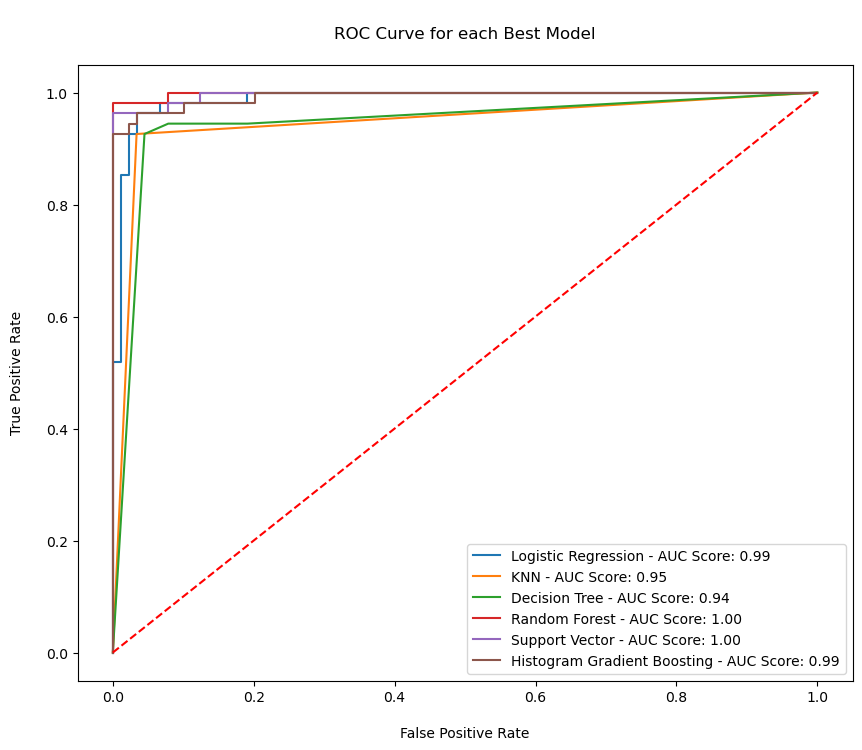

In [549]:
plt.figure(figsize=(10, 8))

# iterate through each best_model to produce a graph of ROC curves and their respective AUC value
for model_name, metrics in model_results.items():
    # obtain best_model
    best_model = metrics['model'] 
    # use the features determined by RFE for the best model
    if hasattr(best_model, "coef_") or hasattr(best_model, "feature_importances_"):
        X_test_features = rfe.transform(X_test)  # Transform X_test
    # if no RFE was applied, use features in best model used in training
    else:
        X_test_features = X_test
    # get predicted probabilities
    y_prob = best_model.predict_proba(X_test_features)[:, 1]
    # calculate ROC cruve - false positive, true positive, and threshold
    fp, tp, th = roc_curve(y_test, y_prob)
    # compute AUC
    auc = roc_auc_score(y_test, y_prob) 
    # plot curve
    plt.plot(fp, tp, label=f'{model_name} - AUC Score: {auc:.2f}')

# diagonal dotted line
plt.plot([0, 1], [0, 1], color='red', linestyle='--')  # Diagonal line
plt.xlabel('\nFalse Positive Rate')
plt.ylabel('True Positive Rate\n')
plt.title('\nROC Curve for each Best Model\n')
plt.legend(loc='lower right')
plt.show()

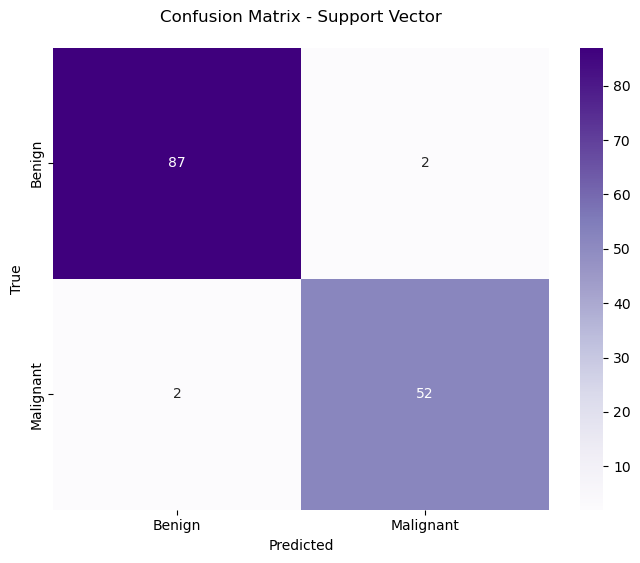

In [554]:
# plot confusion_matrix based on support vector model
best_svc_model = model_results['Support Vector']['model']
X_train_SMOTE, y_train_SMOTE = apply_smote.fit_resample(X_train,y_train)
y_hat_svc_SMOTE = best_svc_model.predict(X_test)

conf_matrix = confusion_matrix(y_test, y_hat_svc_SMOTE)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Purples', 
            xticklabels=['Benign', 'Malignant'], 
            yticklabels=['Benign', 'Malignant'])
plt.ylabel('True')
plt.xlabel('Predicted')
plt.title('Confusion Matrix - Support Vector\n')
plt.show()

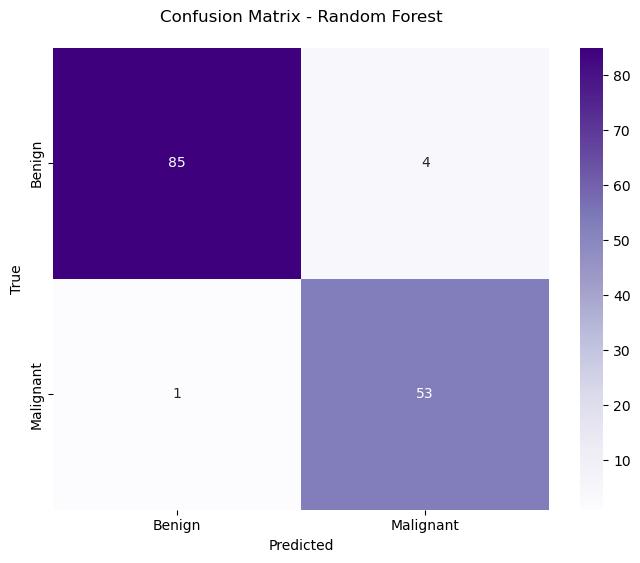

In [558]:
# plot confusion_matrix based on support vector model
best_rf_model = model_results['Random Forest']['model']
X_train_SMOTE, y_train_SMOTE = apply_smote.fit_resample(X_train,y_train)
X_test_rfe = rfe.transform(X_test)
y_hat_rf_SMOTE = best_rf_model.predict(X_test_rfe)

conf_matrix_rf = confusion_matrix(y_test, y_hat_rf_SMOTE)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_rf, annot=True, fmt='d', cmap='Purples', 
            xticklabels=['Benign', 'Malignant'], 
            yticklabels=['Benign', 'Malignant'])
plt.ylabel('True')
plt.xlabel('Predicted')
plt.title('Confusion Matrix - Random Forest\n')
plt.show()

### Discussion and Conclusion

**Discussion of learning and takeaways**: <br>
From exploring the data, applying data techniques, conducting EDA, building and iterating through models to boost performance to analyzing results there are several learnings that I have taken away. First, I have learned that exploring data before attempting to build the models is an essential step that should not be skipped. Otherwise, attempting to produce models on data that is not clean or data type munging is not conducted will produce many frustrating errors that could be avoided from at the onset. Second, visualizing data through a correlation matrix and even better, a heatmap helps identify whether your data has potential for collinearity. It is important to observe this initially so you can plan for implementing techniques to deal with this situation. Third, it is essential to understand whether your data is balanced. Unbalanced data can skew results in the models and provide unreliable predictions that can be critical for certain purposes such as predicting whether someone has breast cancer. Lastly, I have learned that we can create a number of models in a concise way and make the code flexible enough to incorporate new models and attributes such as iterating through hyperparameters where warranted.
<br><br>
**Discussion of why something didn't work**: <br>
There were several areas where I came across pieces I was having trouble with, but prevailed after trail and error. At first I was not able to figure out how to incorporate the recursive feature elimination within my for loop. However, I was able to accomplish this via an if statement and leverage coef_ and feauture_selection_ criteria to isolate models that would allow to select features and iterate through.
<br><br>
Once I got to plotting the best models I didnt realize I needed to store the model results within my for loop. This enabled me to spend sometime through trial and error to get the code right to store the model results of the best models in a dictionary form so that I can call on these models and produce the specific plots.
<br><br>
Lastly, another related issue I came across related to plotting was that some models used less features than others as intended. I needed to figure out how to account for this in my plotting for loop I was implementing to not produce errors of mismatching number of feautres across different models.
<br><br>
**Suggests ways to improve**: <br>
As I went through the analysis, I could not help but wonder how the performance would change for each of the models if we cleaned up the outliers. Would the performance improve? If so, would the same models be the best performing ones (e.g., Support Vector). One of the ways to improve is to conduct an outlier analysis on all the features during the data cleaning step and to remove the identified rows, containing the outliers. Then, I would recommend re-running the models to review whether performance increases.
<br><br>

### References
https://www.kaggle.com/datasets/uciml/breast-cancer-wisconsin-data?resource=download
https://doi.org/10.24432/C5DW2B
https://www.cancer.org/cancer/types/breast-cancer/about/how-common-is-breast-cancer.html
https://machinelearningmastery.com/smote-oversampling-for-imbalanced-classification/
https://numpy.org/doc/stable/
https://pandas.pydata.org/pandas-docs/stable/
https://seaborn.pydata.org/
https://scikit-learn.org/stable/
https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html
https://scikit-learn.org/stable/modules/generated/sklearn.neighbors.KNeighborsClassifier.html
https://scikit-learn.org/stable/modules/generated/sklearn.linear_model.LogisticRegression.html
https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.HistGradientBoostingClassifier.html
https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
https://scikit-learn.org/stable/modules/generated/sklearn.base.clone.html
https://scikit-learn.org/stable/modules/classes.html#module-sklearn.tree
https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html
https://www.statsmodels.org/stable/generated/statsmodels.stats.outliers_influence.variance_inflation_factor.html
https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.accuracy_score.html
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.classification_report.html
https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.RFE.html
https://imbalanced-learn.org/stable/
https://imbalanced-learn.org/stable/references/generated/imblearn.over_sampling.SMOTE.html
https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_val_score.html
https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.GridSearchCV.html
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_auc_score.html
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.roc_curve.html
https://scikit-learn.org/stable/modules/generated/sklearn.metrics.confusion_matrix.html
https://matplotlib.org/stable/contents.html